In [2]:
# Packages
import numpy as np
import pandas as pd
#import seaborn as sn
import matplotlib.pyplot as plt
import datetime
#from All_data_muduo import df,f1
#//*** Use the whole window in the IPYNB editor
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

#//*** Maximize columns and rows displayed by pandas
# pd.set_option('display.max_rows', 1000)
# pd.set_option('display.max_columns',20 )

## There are two sets of results here ##
The First set: "./results/Linear_Regression_Daily_all_comments_v1.csv.pkl" uses all the comments on a given day. This goes back to your original idea of using all the terms and let the model pick the important ones. The basic tfidf was generating better scores than the version that only used comments that mention the symbols. This is more computationally expensive when building the data sets and minimally more expensive when modeling. I think this is a better path.

The Second Set: "./results/Linear_Regression_Daily_v2.csv.pkl" has comments that only mention the stock symbol. I initially used this as a feature reduction. But since adding trigrams and 


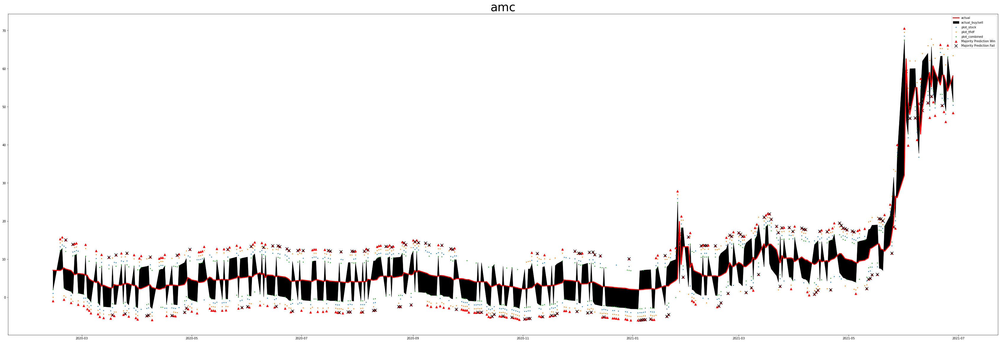

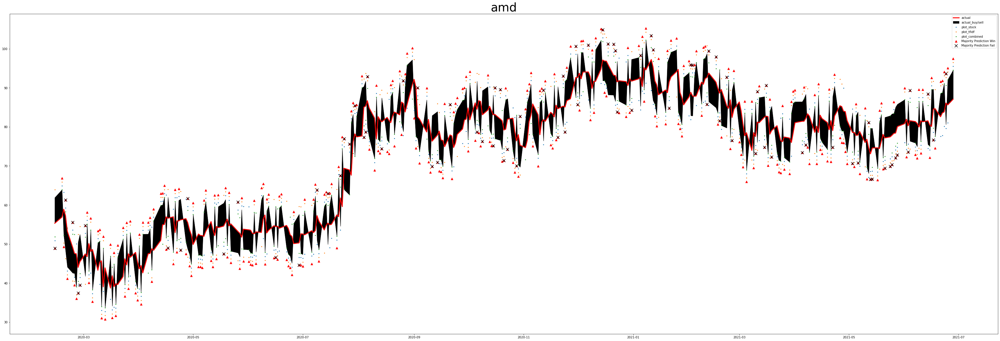

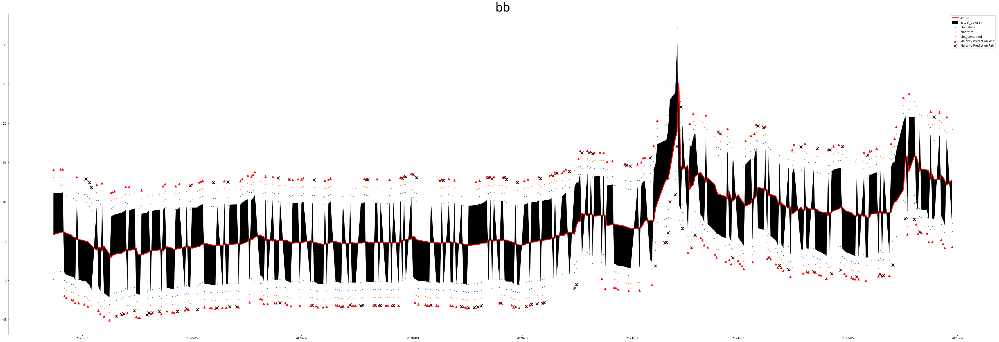

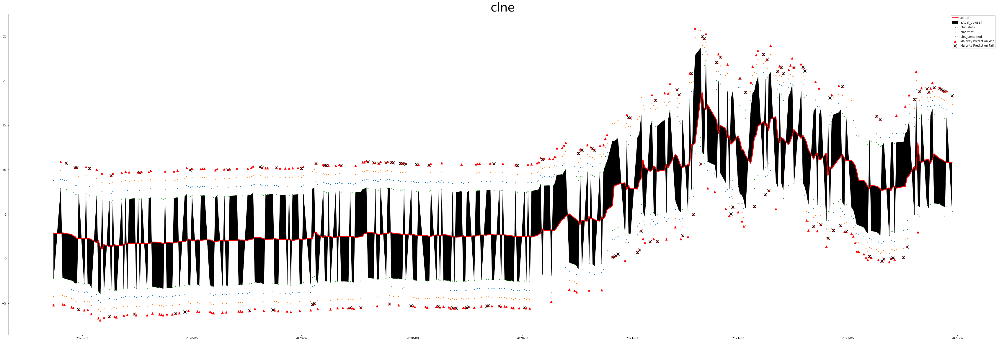

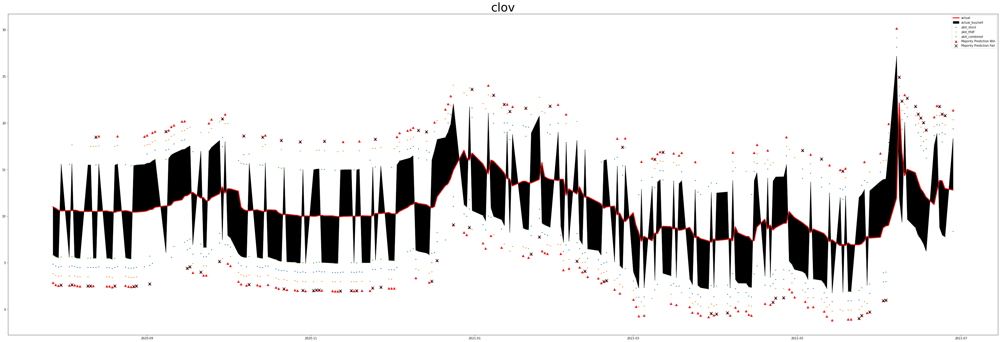

...

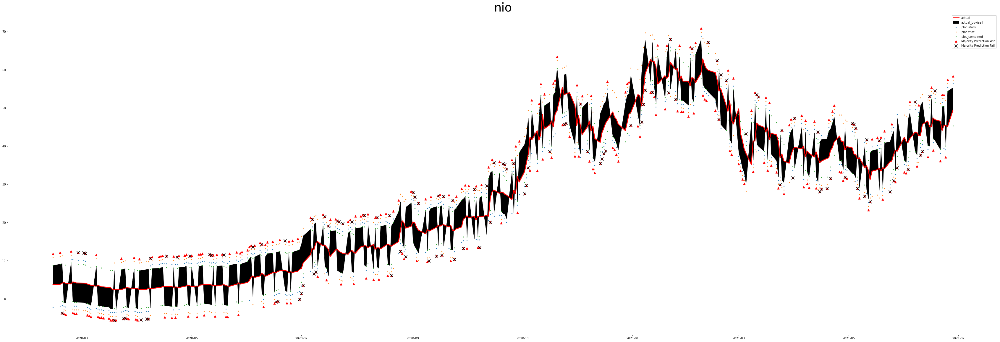

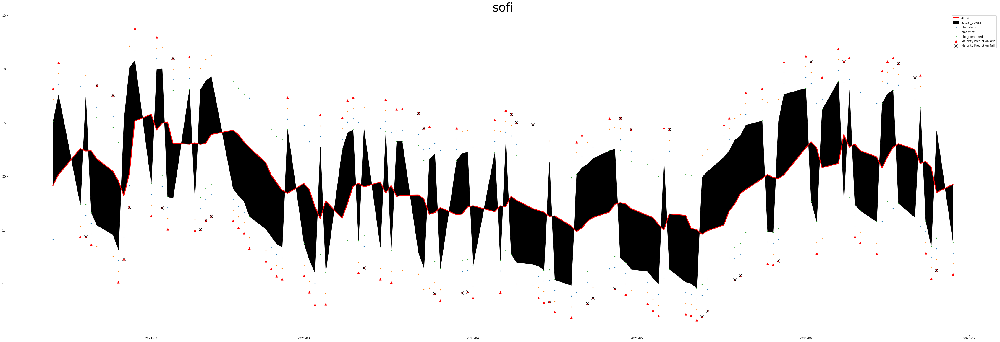

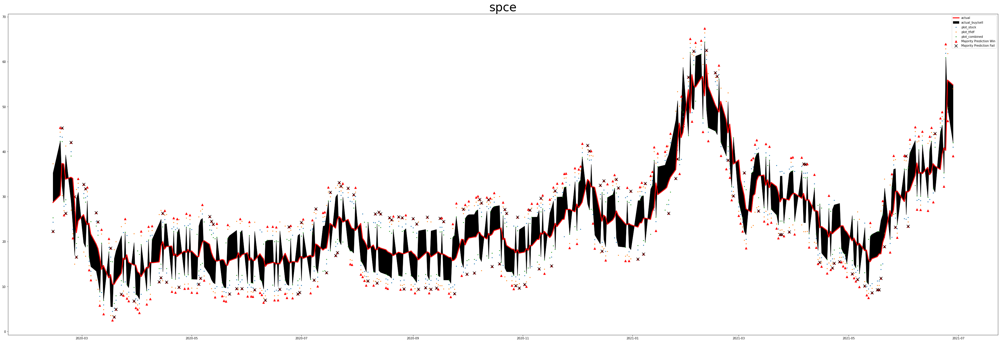

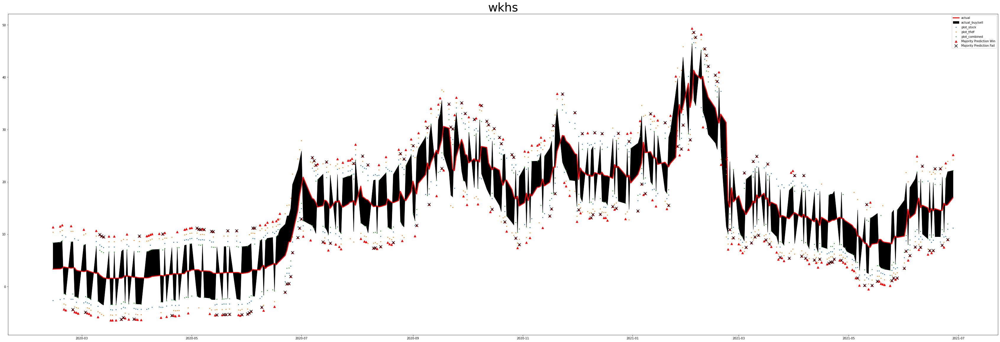

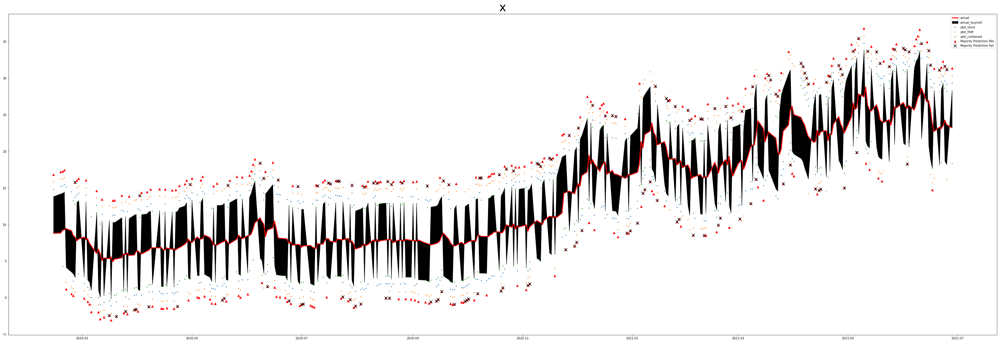

In [151]:
#input_filename = './results/results_amc_1min_MLPRegressor_v1.pkl.zip'
#input_filename = "./results_amc_daily_kmeans_ols.pkl"
#input_filename = "./results/results_all_stocks_LinearRegression_Daily_v1.csv.pkl"
#input_filename = "./results/results_ensemble_Daily_v2.csv.pkl"
#input_filename = "./results/Linear_Regression_Daily_v2.csv.pkl"
input_filename = "./results/Linear_Regression_Daily_all_comments_v1.csv.pkl"

results_df = pd.read_pickle(input_filename)

for group in results_df.groupby('symbol'):
    
    
    loop_df = pd.DataFrame(group[1])
    
    model_cols = loop_df.columns[4:]
    
    loop_df['action'] = pd.Series(loop_df['predict'] - loop_df['actual'])
    #//*** Set Negative Values to Zero
    
    loop_df['action'] = loop_df['action'].clip(0)
    #//*** Set Positive Values to 1. Values greater than .0001 are set to .0001 then replaced with 1. Hacky, but functional
    loop_df['action'] = loop_df['action'].clip(0,.0001).replace(.0001,1)
    
    loop_df['plot_action'] = loop_df['action'].replace(0,-5).replace(1,5)+loop_df['predict']

    min_counter=-5
    max_counter=5

    #//*** Loop through the model columns
    for col in model_cols:

    
        loop_df[col.replace("linear_","action_")] = loop_df['predict'] - loop_df[col]
        #//*** Set Negative Values to Zero
        loop_df[col.replace("linear_","action_")] = loop_df[col.replace("linear_","action_")].clip(0)
        #//*** Set Positive Values to 1. Values greater than .0001 are set to .0001 then replaced with 1. Hacky, but functional
        loop_df[col.replace("linear_","action_")] = loop_df[col.replace("linear_","action_")].clip(0,.0001).replace(.0001,1)
        loop_df[col.replace("linear_","plot_")] = loop_df[col.replace("linear_","action_")].replace(0,min_counter).replace(1,max_counter)+loop_df['predict']
        
        min_counter -= 1
        max_counter += 1
    loop_df['action_majority'] = loop_df['action_combined'] + loop_df['action_stock'] + loop_df['action_tfidf']
    #loop_df['acc_combined'] = (loop_df['action'] == loop_df['action_combined']).astype(int)
    #loop_df['acc_stock'] = (loop_df['action'] == loop_df['action_stock']).astype(int)
    #loop_df['acc_tfidf'] = (loop_df['action'] == loop_df['action_tfidf']).astype(int)
    #loop_df['acc_majority'] = loop_df['acc_combined'] + loop_df['acc_stock'] + loop_df['acc_tfidf']
    
    
    loop_df.loc[(loop_df['action_majority'] < 2 ),'action_majority']=0
    loop_df.loc[(loop_df['action_majority'] >= 2),'action_majority']=1
    loop_df['plot_majority'] = loop_df['action_majority'].replace(0,min_counter).replace(1,max_counter)+loop_df['predict']
    loop_df['acc_majority'] = (loop_df['action'] == loop_df['action_majority']).astype(int)
    loop_df['plot_acc_majority'] = loop_df['acc_majority'].replace(1,np.nan) + loop_df['plot_majority']
    #loop_df['plot_acc_win'] = loop_df['acc_majority'].replace(0,np.nan).replace(1,10)+loop_df['predict']
    #loop_df['plot_acc_fail'] = loop_df['acc_majority'].replace(0,-10).replace(1,np.nan)+loop_df['predict']
    
    #print(loop_df.tail(30))
    symbol = group[1]['symbol']
    time = group[1]['time']
    
    
    #rmse = group[1]['rmse']
    #r2 = group[1]['r2']
    actual = group[1]['predict']
    #predict = group[1]['predict']

    fig,ax = plt.subplots()

    fig.set_figheight(20)
    fig.set_figwidth(60)

    
    ax.fill_between(time,group[1]['plot_action'],group[1]['actual'],label='actual_buy/sell',color='black',linewidth=1 )
    ax.plot(time,group[1]['actual'],label='actual',color='red',linewidth=3 )
    #for col in results_df.columns[4:7]:
    #    ax.plot(time,group[1][col],label=col )
    for col in ['plot_stock','plot_tfidf','plot_combined']:
        ax.scatter(time,group[1][col],label=col,s=5 )

    ax.scatter(time,group[1]['plot_majority'],label='Majority Prediction Win',color='red',marker="^",s=50)
    ax.scatter(time,group[1]['plot_acc_majority'],label='Majority Prediction Fail',color='black',marker="x",s=100)
    #ax.scatter(time,group[1]['plot_acc_fail'],label='Accurate Prediction',color='red',marker="x")
    
    
    
    #ax.plot(time,actual)
    #ax.scatter(plot_x,predict,color='red' )
    #ax.plot(plot_x,predict_df['linear'],color='red' )
    plt.title(group[0],fontsize=40)
    #plt.suptitle(f"r2: {round(r2,4)} rmse: {round(rmse,4)}")
    plt.legend()
    plt.show()
    
    

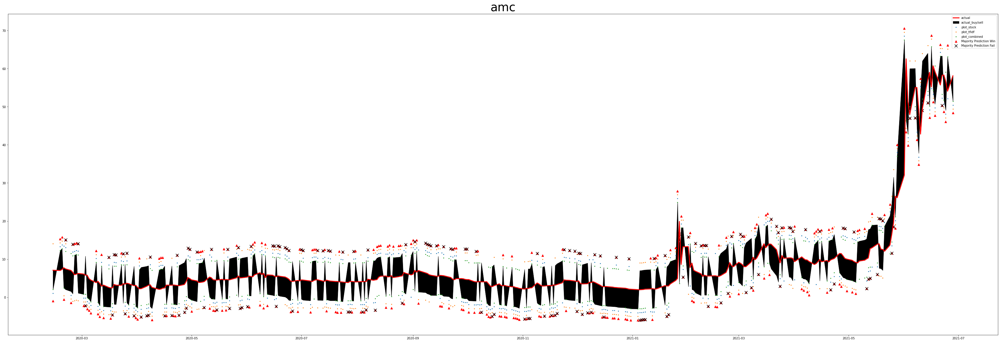

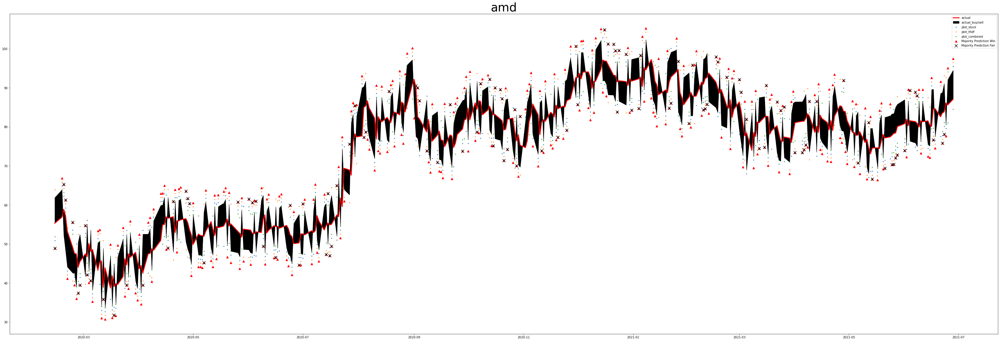

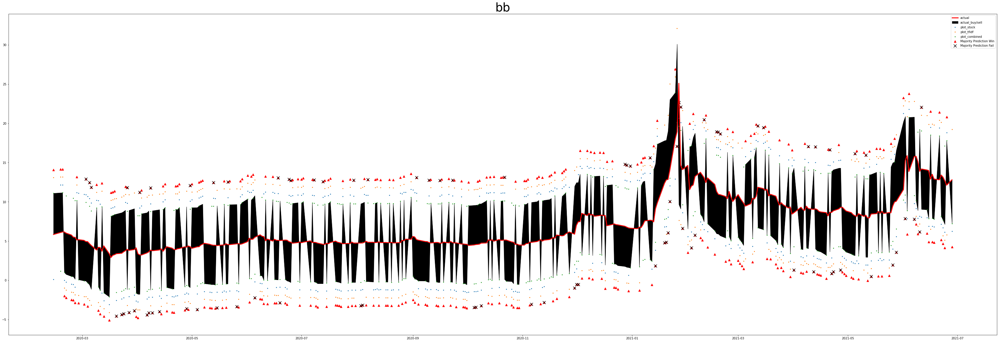

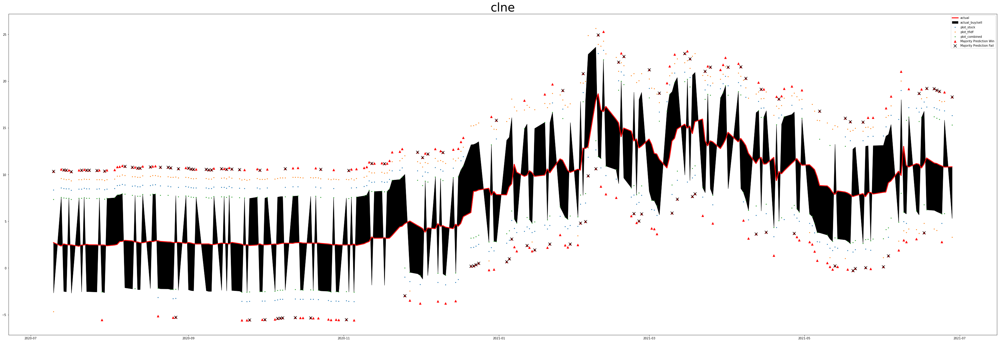

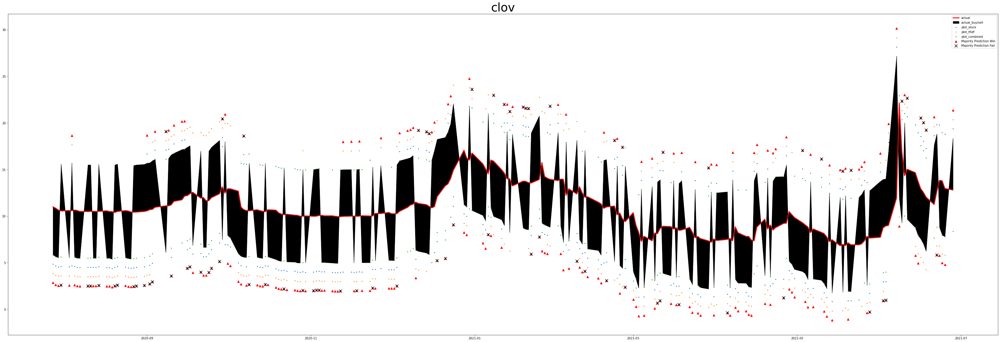

...

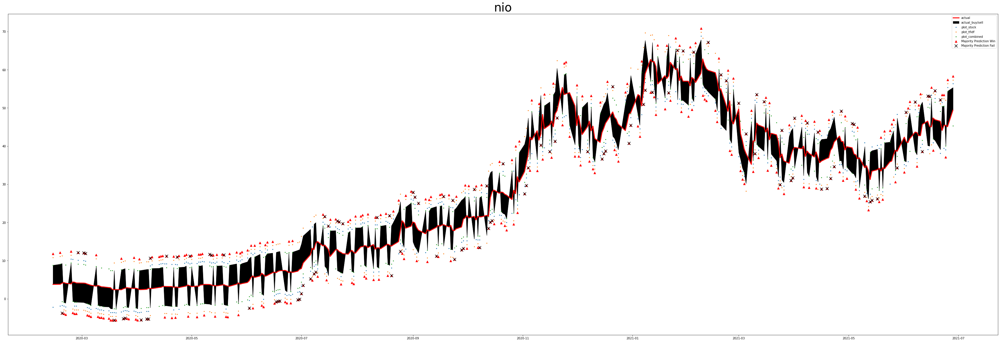

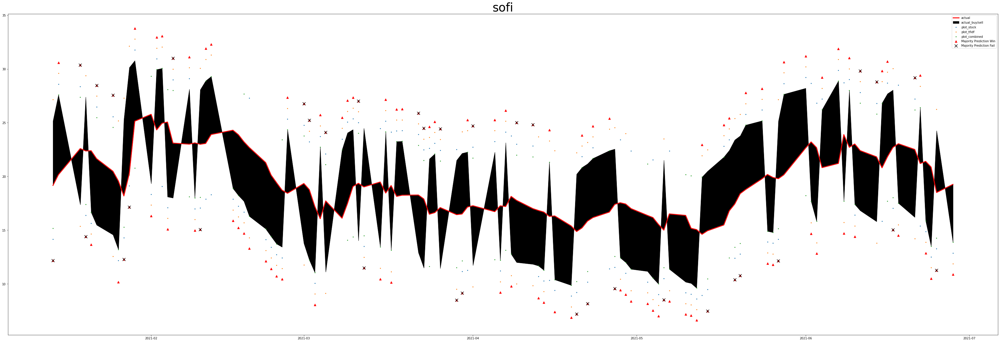

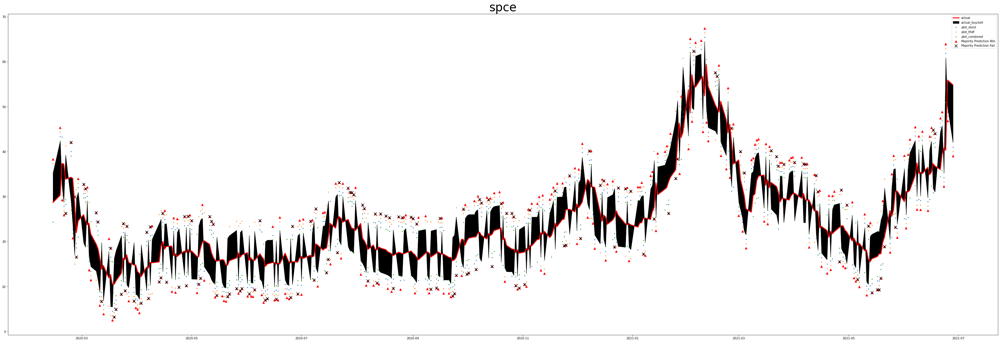

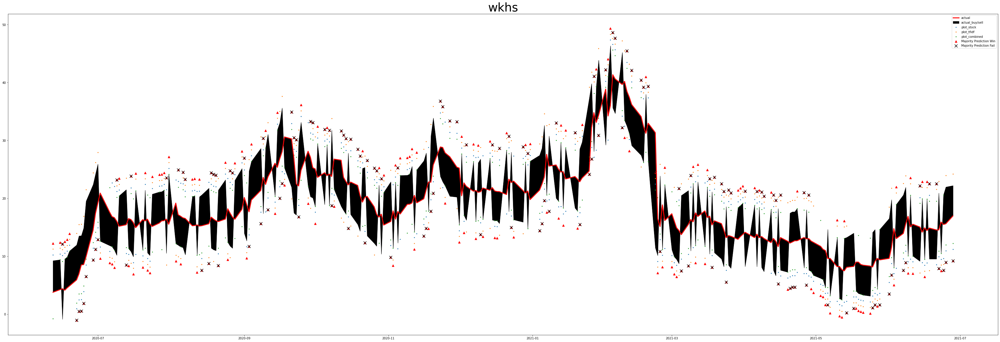

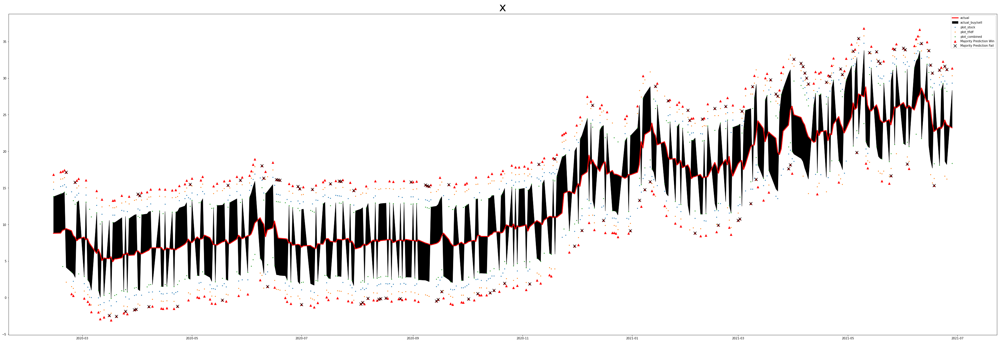

In [149]:
#input_filename = './results/results_amc_1min_MLPRegressor_v1.pkl.zip'
#input_filename = "./results_amc_daily_kmeans_ols.pkl"
#input_filename = "./results/results_all_stocks_LinearRegression_Daily_v1.csv.pkl"
input_filename = "./results/results_ensemble_Daily_v2.csv.pkl"
input_filename = "./results/Linear_Regression_Daily_v2.csv.pkl"

results_df = pd.read_pickle(input_filename)

for group in results_df.groupby('symbol'):
    
   
    loop_df = pd.DataFrame(group[1])
    
    model_cols = loop_df.columns[4:]
    
    loop_df['action'] = pd.Series(loop_df['predict'] - loop_df['actual'])
    #//*** Set Negative Values to Zero
    
    loop_df['action'] = loop_df['action'].clip(0)
    #//*** Set Positive Values to 1. Values greater than .0001 are set to .0001 then replaced with 1. Hacky, but functional
    loop_df['action'] = loop_df['action'].clip(0,.0001).replace(.0001,1)
    
    loop_df['plot_action'] = loop_df['action'].replace(0,-5).replace(1,5)+loop_df['predict']

    min_counter=-5
    max_counter=5

    #//*** Loop through the model columns
    for col in model_cols:

    
        loop_df[col.replace("linear_","action_")] = loop_df['predict'] - loop_df[col]
        #//*** Set Negative Values to Zero
        loop_df[col.replace("linear_","action_")] = loop_df[col.replace("linear_","action_")].clip(0)
        #//*** Set Positive Values to 1. Values greater than .0001 are set to .0001 then replaced with 1. Hacky, but functional
        loop_df[col.replace("linear_","action_")] = loop_df[col.replace("linear_","action_")].clip(0,.0001).replace(.0001,1)
        loop_df[col.replace("linear_","plot_")] = loop_df[col.replace("linear_","action_")].replace(0,min_counter).replace(1,max_counter)+loop_df['predict']
        
        min_counter -= 1
        max_counter += 1
    loop_df['action_majority'] = loop_df['action_combined'] + loop_df['action_stock'] + loop_df['action_tfidf']
    #loop_df['acc_combined'] = (loop_df['action'] == loop_df['action_combined']).astype(int)
    #loop_df['acc_stock'] = (loop_df['action'] == loop_df['action_stock']).astype(int)
    #loop_df['acc_tfidf'] = (loop_df['action'] == loop_df['action_tfidf']).astype(int)
    #loop_df['acc_majority'] = loop_df['acc_combined'] + loop_df['acc_stock'] + loop_df['acc_tfidf']
    
    
    loop_df.loc[(loop_df['action_majority'] < 2 ),'action_majority']=0
    loop_df.loc[(loop_df['action_majority'] >= 2),'action_majority']=1
    loop_df['plot_majority'] = loop_df['action_majority'].replace(0,min_counter).replace(1,max_counter)+loop_df['predict']
    loop_df['acc_majority'] = (loop_df['action'] == loop_df['action_majority']).astype(int)
    loop_df['plot_acc_majority'] = loop_df['acc_majority'].replace(1,np.nan) + loop_df['plot_majority']
    #loop_df['plot_acc_win'] = loop_df['acc_majority'].replace(0,np.nan).replace(1,10)+loop_df['predict']
    #loop_df['plot_acc_fail'] = loop_df['acc_majority'].replace(0,-10).replace(1,np.nan)+loop_df['predict']
    
    #print(loop_df.tail(30))
    symbol = group[1]['symbol']
    time = group[1]['time']
    
    
    #rmse = group[1]['rmse']
    #r2 = group[1]['r2']
    actual = group[1]['predict']
    #predict = group[1]['predict']

    fig,ax = plt.subplots()

    fig.set_figheight(20)
    fig.set_figwidth(60)

    
    ax.fill_between(time,group[1]['plot_action'],group[1]['actual'],label='actual_buy/sell',color='black',linewidth=1 )
    ax.plot(time,group[1]['actual'],label='actual',color='red',linewidth=3 )
    #for col in results_df.columns[4:7]:
    #    ax.plot(time,group[1][col],label=col )
    for col in ['plot_stock','plot_tfidf','plot_combined']:
        ax.scatter(time,group[1][col],label=col,s=5 )

    ax.scatter(time,group[1]['plot_majority'],label='Majority Prediction Win',color='red',marker="^",s=50)
    ax.scatter(time,group[1]['plot_acc_majority'],label='Majority Prediction Fail',color='black',marker="x",s=100)
    #ax.scatter(time,group[1]['plot_acc_fail'],label='Accurate Prediction',color='red',marker="x")
    
    
    
    #ax.plot(time,actual)
    #ax.scatter(plot_x,predict,color='red' )
    #ax.plot(plot_x,predict_df['linear'],color='red' )
    plt.title(group[0],fontsize=40)
    #plt.suptitle(f"r2: {round(r2,4)} rmse: {round(rmse,4)}")
    plt.legend()
    plt.show()
    
    

# Keeping the cells below as a reminder of how far we've come #

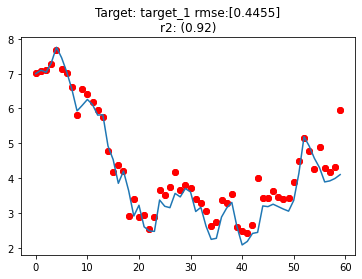

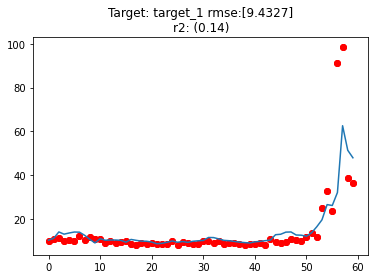

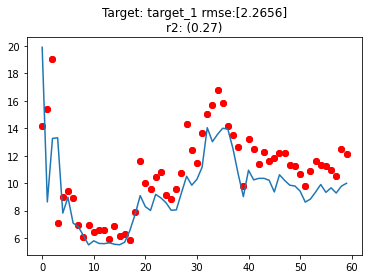

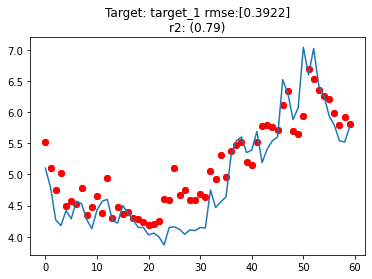

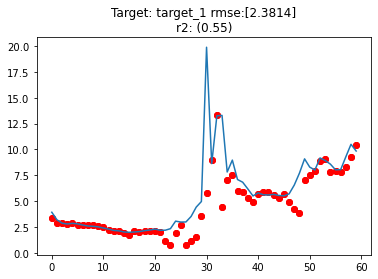

...

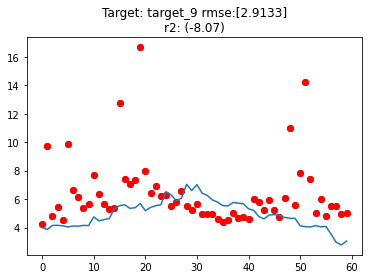

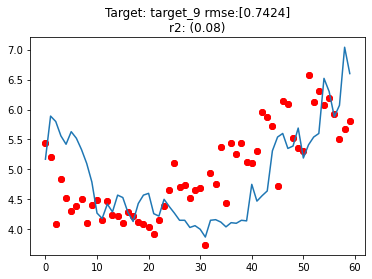

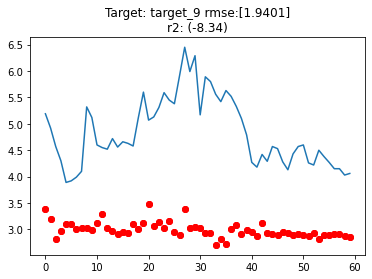

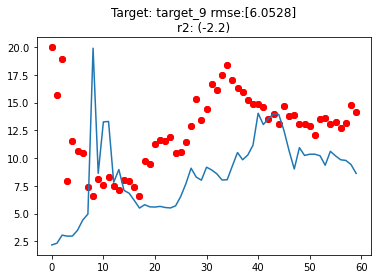

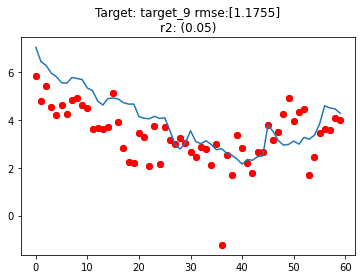

In [19]:
for group in results_df.sort_values('target').groupby('target'):
    if group[0] =='target_10':
        last_df = group[0]
        continue
    for row in group[1].iterrows():
        row = row[1]
        #//*** PLot Results
        fig,ax = plt.subplots()

        #//*** Build an integer list for the x axis
        plot_x = np.arange(len(row['actual']))
        #print(plot_x)
        #print(np.array(row['actual'].flatten()))
        #//*** Plot Predictions
        ax.scatter(plot_x,np.array(row['predict']),color='red' )
        #//*** Plot Actual values as a line
        ax.plot(plot_x,np.array(row['actual']) )

        #//*** Plot Predictions
        ax.scatter(plot_x,row['predict'],color='red' )

        title= ""
        #title+=f"Training Range: {row['start']} - {row['end']}\n"
        #title+=f"Prediction Range: {row['end']} - {row['end'] + row['predict_range']}\n"
        title+=f"Target: {row['target']} rmse:[{round(row['rmse'],4)}]\nr2: ({round(row['r2'],2)})"
        plt.title(title)    
        plt.show()
    
    

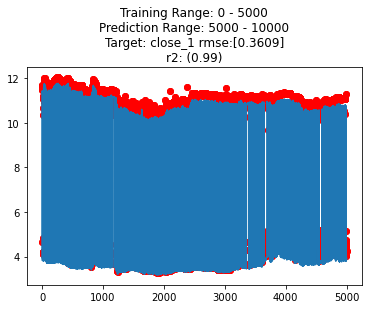

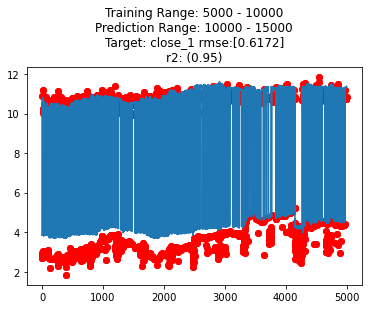

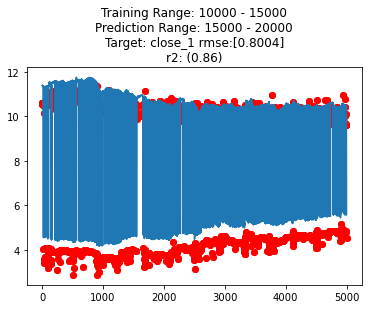

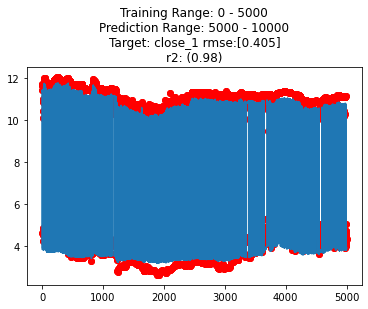

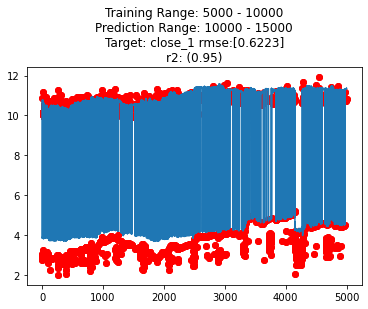

...

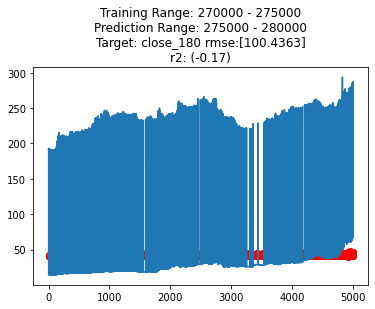

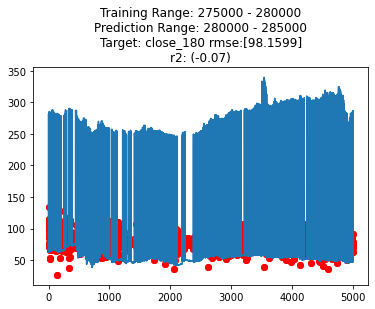

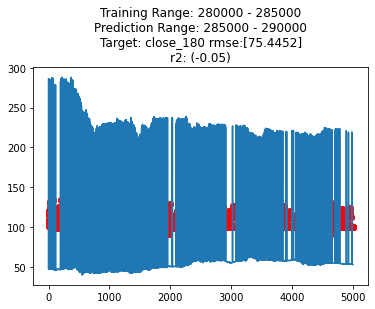

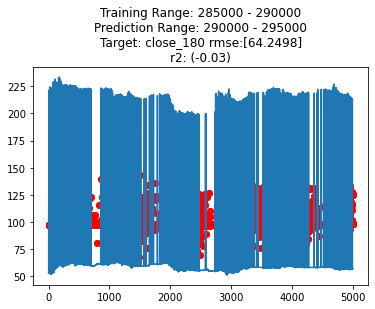

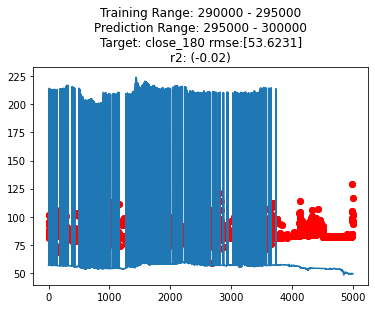

In [21]:


for row in results_df.iterrows():
    row = row[1]
    #//*** PLot Results
    fig,ax = plt.subplots()

    #//*** Build an integer list for the x axis
    plot_x = np.arange(len(row['actual']))

    #//*** Plot Predictions
    ax.scatter(plot_x,row['predict'],color='red' )
    #//*** Plot Actual values as a line
    ax.plot(plot_x,row['actual'] )

    #//*** Plot Predictions
    ax.scatter(plot_x,row['predict'],color='red' )

    title= ""
    title+=f"Training Range: {row['start']} - {row['end']}\n"
    title+=f"Prediction Range: {row['end']} - {row['end'] + row['predict_range']}\n"
    title+=f"Target: {row['target']} rmse:[{round(row['rmse'],4)}]\nr2: ({round(row['r2'],2)})"
    plt.title(title)    
    plt.show()